In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.api import seasonal_decompose
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error

Load the wheather data

In [3]:
file_path = "C:/Users/Surface/Downloads/Data set-20231220/weather_revised.csv"
weather_data = pd.read_csv(file_path, parse_dates=['date'], index_col='date')

Extracting the variable based on last digit of student number ( 0 is last digit here)

In [4]:
last_digit = 0  
variables = {0: 'maxtp(Maximum Air Temperature - degrees C)', 1: 'maxtp', 2: 'mintp', 3: 'mintp', 4: 'gmin', 5: 'gmin', 6: 'cbl', 7: 'cbl', 8: 'wdsp', 9: 'wdsp'}
selected_variable = variables[last_digit]


Extract the relevant time series

In [5]:
time_series = weather_data[selected_variable]

Preliminary Assessment (Visualisations)

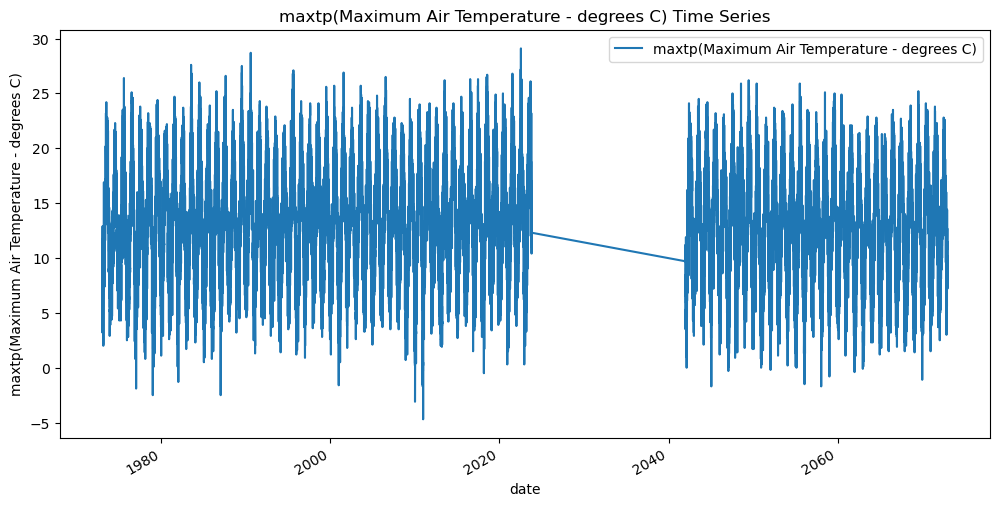

In [7]:
time_series.plot(figsize=(12, 6), label=selected_variable)
plt.title(f'{selected_variable} Time Series')
plt.xlabel('date')
plt.ylabel(selected_variable)
plt.legend()
plt.show()

Decompose the time series to identify trend, seasonality, and residuals

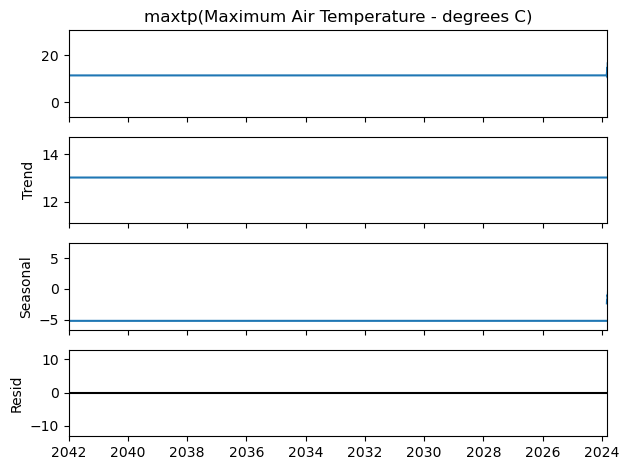

In [8]:
result = seasonal_decompose(time_series, model='additive', period=365)
result.plot()
plt.show()

Simple Time Series Models

In [9]:
mean_model_forecast = time_series.mean()
naive_model_forecast = time_series.shift(1).iloc[-1]


Exponential Smoothing

In [10]:
model_es = ExponentialSmoothing(time_series, seasonal='add', seasonal_periods=365)
fit_es = model_es.fit()


C:\Users\Surface\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\Surface\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


Sarima Model

In [12]:
model_sarima = SARIMAX(time_series['2019':'2022'], order=(1, 1, 1), seasonal_order=(1, 1, 1, 30))
fit_sarima = model_sarima.fit()


C:\Users\Surface\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
C:\Users\Surface\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


Forecasting

In [13]:
forecast_sarima = fit_sarima.get_forecast(steps=len(time_series['2023':]))

Train and Test Data

In [14]:
train_data = time_series['2019':'2022']
test_data = time_series['2023':]

Forecast using each model

In [15]:
mean_model_predictions = [mean_model_forecast] * len(test_data)
naive_model_predictions = [naive_model_forecast] * len(test_data)
es_predictions = fit_es.forecast(len(test_data))
sarima_predictions = fit_sarima.get_forecast(len(test_data)).predicted_mean


C:\Users\Surface\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\Surface\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


Evaluate the models

In [16]:
mae_mean_model = mean_absolute_error(test_data, mean_model_predictions)
mae_naive_model = mean_absolute_error(test_data, naive_model_predictions)
mae_es = mean_absolute_error(test_data, es_predictions)
mae_sarima = mean_absolute_error(test_data, sarima_predictions)


Display results

In [17]:
print(f"MAE for Mean Model: {mae_mean_model}")
print(f"MAE for Naive Model: {mae_naive_model}")
print(f"MAE for Exponential Smoothing: {mae_es}")
print(f"MAE for SARIMA: {mae_sarima}")


MAE for Mean Model: 4.081073840069873
MAE for Naive Model: 4.079745420142771
MAE for Exponential Smoothing: 3.659094599155857
MAE for SARIMA: 4.358250889433738


Plot actual vs. predicted values

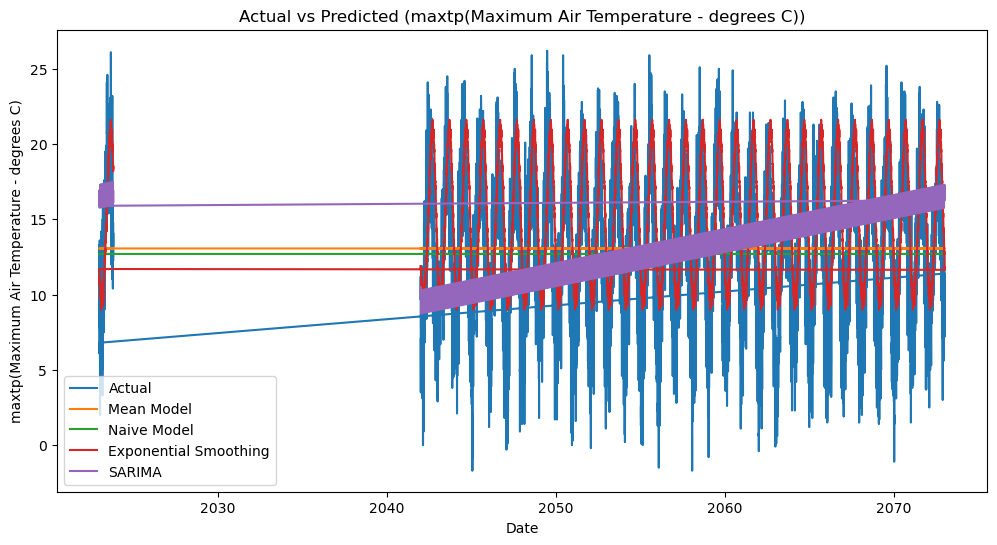

In [18]:
plt.figure(figsize=(12, 6))
plt.plot(test_data.index, test_data, label='Actual')
plt.plot(test_data.index, mean_model_predictions, label='Mean Model')
plt.plot(test_data.index, naive_model_predictions, label='Naive Model')
plt.plot(test_data.index, es_predictions, label='Exponential Smoothing')
plt.plot(test_data.index, sarima_predictions, label='SARIMA')
plt.title(f'Actual vs Predicted ({selected_variable})')
plt.xlabel('Date')
plt.ylabel(selected_variable)
plt.legend()
plt.show()

Time series plot

In [19]:
import plotly.express as px

fig = px.line(time_series, x=time_series.index, y=selected_variable, title=f'{selected_variable} Time Series', labels={'x': 'Date', 'y': selected_variable})
fig.update_layout(xaxis_title='Date', yaxis_title=selected_variable)
fig.show()


Decomposition plot

In [20]:
import plotly.graph_objects as go

result = seasonal_decompose(time_series, model='additive', period=365)

fig = go.Figure()

fig.add_trace(go.Scatter(x=time_series.index, y=result.observed, mode='lines', name='Observed'))

fig.add_trace(go.Scatter(x=time_series.index, y=result.trend, mode='lines', name='Trend'))

fig.add_trace(go.Scatter(x=time_series.index, y=result.seasonal, mode='lines', name='Seasonal'))

fig.add_trace(go.Scatter(x=time_series.index, y=result.resid, mode='lines', name='Residual'))

fig.update_layout(title='Time Series Decomposition',
                  xaxis_title='Date',
                  yaxis_title='Value',
                  legend_title='Component')

fig.show()


Model forecsating plot

In [21]:
import plotly.express as px


fig = px.line(title=f'Actual vs Predicted ({selected_variable})', labels={'index': 'Date', 'value': selected_variable})

fig.add_scatter(x=test_data.index, y=test_data, mode='lines', name='Actual')
fig.add_scatter(x=test_data.index, y=mean_model_predictions, mode='lines', name='Mean Model')
fig.add_scatter(x=test_data.index, y=naive_model_predictions, mode='lines', name='Naive Model')
fig.add_scatter(x=test_data.index, y=es_predictions, mode='lines', name='Exponential Smoothing')
fig.add_scatter(x=test_data.index, y=sarima_predictions, mode='lines', name='SARIMA')

fig.update_layout(xaxis_title='Date', yaxis_title=selected_variable, legend_title='Legend')
fig.show()


Residual plot for SARIMA

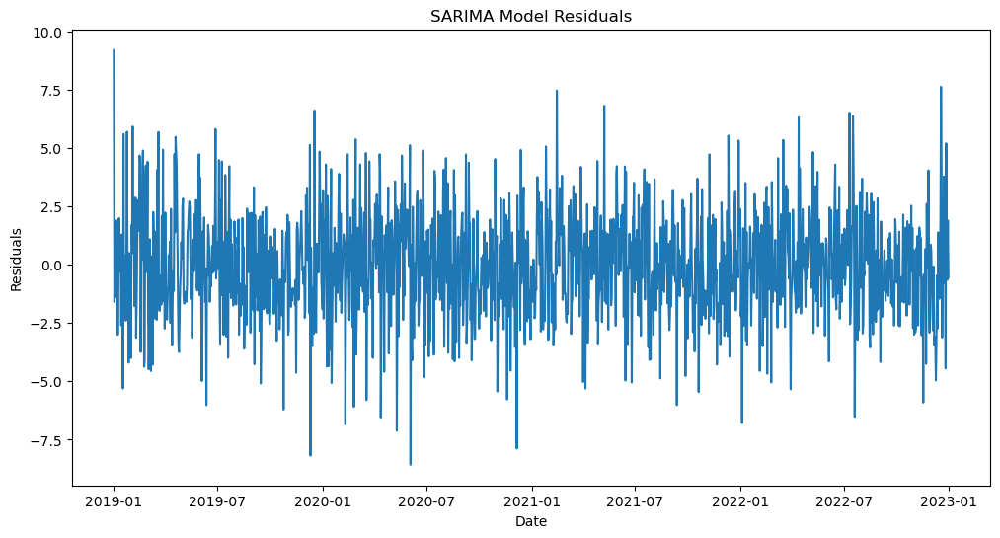

In [22]:
plt.figure(figsize=(12, 6))
plt.plot(fit_sarima.resid)
plt.title('SARIMA Model Residuals')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.show()

Forecast Confidence Intervals for SARIMA:

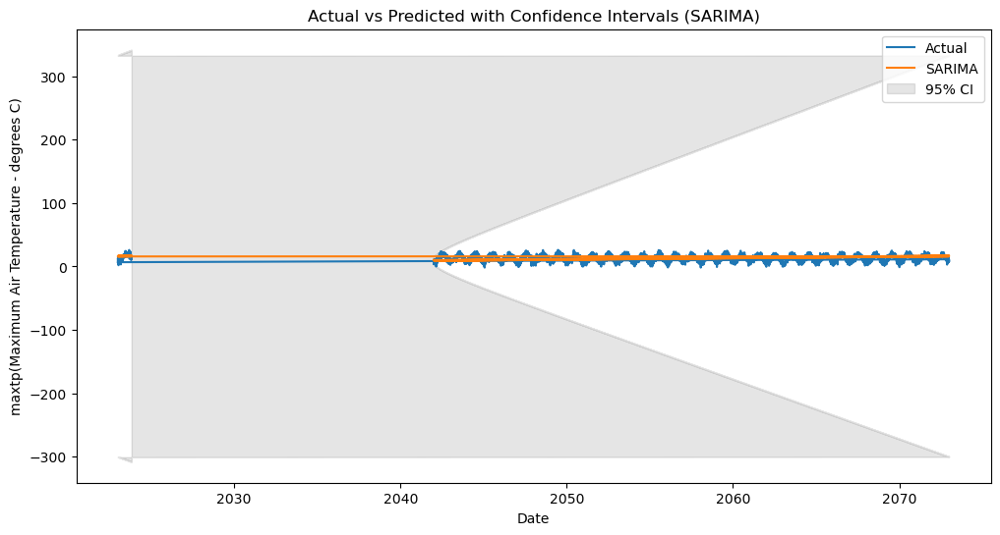

In [23]:
forecast_ci = fit_sarima.get_forecast(len(test_data)).conf_int()
plt.figure(figsize=(12, 6))
plt.plot(test_data.index, test_data, label='Actual')
plt.plot(test_data.index, sarima_predictions, label='SARIMA')
plt.fill_between(test_data.index, forecast_ci.iloc[:, 0], forecast_ci.iloc[:, 1], color='k', alpha=0.1, label='95% CI')
plt.title('Actual vs Predicted with Confidence Intervals (SARIMA)')
plt.xlabel('Date')
plt.ylabel(selected_variable)
plt.legend()
plt.show()

Autocorrelation and Partial Autocorrelation Plots

<Figure size 1200x600 with 0 Axes>

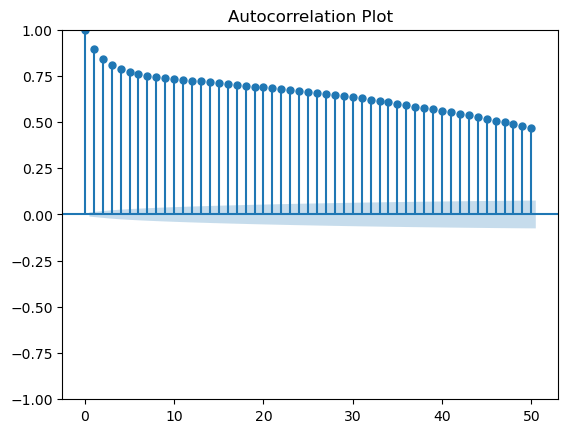

<Figure size 1200x600 with 0 Axes>

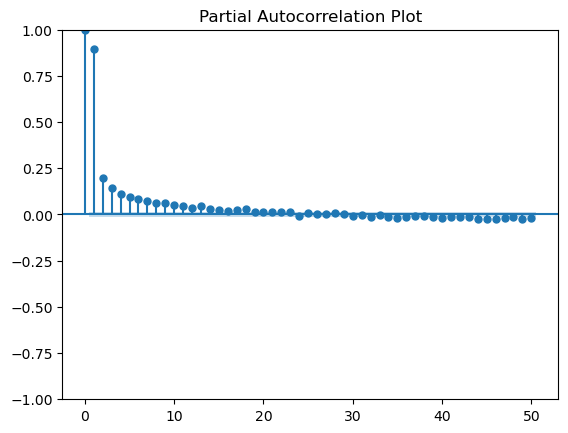

In [25]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plt.figure(figsize=(12, 6))
plot_acf(time_series, lags=50, title='Autocorrelation Plot')
plt.show()

plt.figure(figsize=(12, 6))
plot_pacf(time_series, lags=50, title='Partial Autocorrelation Plot')
plt.show()